<a href="https://www.kaggle.com/awsaf49/happywhale-data-distribution?scriptVersionId=86836823" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# [Happywhale - Whale and Dolphin Identification](https://www.kaggle.com/c/happy-whale-and-dolphin)
> Identify whales and dolphins by unique characteristic

<img src="https://storage.googleapis.com/kaggle-competitions/kaggle/22962/logos/header.png?t=2021-03-17-22-44-09">

# Methodology 📌
* In this notebook we'll demonstrante how to check data distribution using **T-SNE**.
* We'll utilize `timm` library for pretrained models to generate **image-embeddings**.
    * For this notebook we'll be using `tf-efficientnet-b0` model.
    * Image size is kept `224x224`
    * Final feature vector has dimension of `1280` (output of the **pooling layer** of `tf-efficientnet-b0`)
* We'll use **cuML** library from **RAPIDS** for **T-SNE**.
* We'll also use **WandB** for visulization. Now, **WandB** allows you to plot **image embedding** directly. :)
* We'll also check sample images from different locations of **vector-space**.
* We'll check different data distribution
    * Train Vs Test
    * Whales Vs Dolphins
    * Whales Speices
    * Dolphins Species
* There are individuals in the test data that are not observed in the training data, which should be predicted as `new_individual`.
* **Question:** Will we be able to identify those `new_individual` from **image embeddings**?

> So, follow me, and dare to face the unknown, and ponder the question: What if? ;)

<img src="https://everythingmarvel.net/wp-content/uploads/what-if-quotes.jpg" width=1000>

# Install Libraries 🛠

In [1]:
!pip install -q timm
!pip install -qU wandb

# Import Libraries 📚

In [2]:
import os
from glob import glob
from tqdm.notebook import tqdm
import numpy as np
import random
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import timm

import cuml
import wandb
import IPython.display as ipd

# Notebook Config ⚙️

In [3]:
class CFG:
    seed          = 42
    base_path     = '../input/happy-whale-and-dolphin'
    num_samples   = None #  None for all samples
    device        = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    competition   = 'happywhale'
    _wandb_kernel = 'awsaf49'

# Reproducibility ♻

In [4]:
def seed_torch(seed_value):
    random.seed(seed_value) # Python
    np.random.seed(seed_value) # cpu vars
    torch.manual_seed(seed_value) # cpu  vars    
    if torch.cuda.is_available(): 
        torch.cuda.manual_seed(seed_value)
        torch.cuda.manual_seed_all(seed_value) # gpu vars
    if torch.backends.cudnn.is_available:
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False
    print('# SEEDING DONE')
seed_torch(CFG.seed)

# SEEDING DONE


# ⭐ WandB
<div align=center> <img src="https://camo.githubusercontent.com/dd842f7b0be57140e68b2ab9cb007992acd131c48284eaf6b1aca758bfea358b/68747470733a2f2f692e696d6775722e636f6d2f52557469567a482e706e67" width=500></div>

Weights & Biases (W&B) is MLOps platform for tracking our experiemnts. We can use it to Build better models faster with experiment tracking, dataset versioning, and model management. Some of the cool features of W&B:

* Track, compare, and visualize ML experiments
* Get live metrics, terminal logs, and system stats streamed to the centralized dashboard.
* Explain how your model works, show graphs of how model versions improved, discuss bugs, and demonstrate progress towards milestones.

In [5]:
import wandb

try:
    from kaggle_secrets import UserSecretsClient
    user_secrets = UserSecretsClient()
    api_key = user_secrets.get_secret("WANDB")
    wandb.login(key=api_key)
    anonymous = None
except:
    anonymous = "must"
    wandb.login(anonymous=anonymous)
    print('To use your W&B account,\nGo to Add-ons -> Secrets and provide your W&B access token. Use the Label name as WANDB. \nGet your W&B access token from here: https://wandb.ai/authorize')

wandb: W&B API key is configured (use `wandb login --relogin` to force relogin)
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


# Meta Data 📈
* `train_images/` - a folder containing the training images
* `train.csv` - provides the species and the individual_id for each of the training images
* `test_images/` - a folder containing the test images; for each image, your task is to predict the individual_id; no species information is given for the test data; there are individuals in the test data that are not observed in the training data, which should be predicted as new_individual.
* `sample_submission.csv` - a sample submission file in the correct format

> Note: We don't have access to `species` column for **test** data. So, we can direcly use `species` for **train**.

In [6]:
df = pd.read_csv(f'{CFG.base_path}/train.csv')
df['image_path'] = CFG.base_path+'/train_images/'+df['image']
df['split'] = 'Train'

test_df = pd.read_csv(f'{CFG.base_path}/sample_submission.csv')
test_df['image_path'] = CFG.base_path+'/test_images/'+test_df['image']
test_df['split'] = 'Test'

print('Train Images: {:,} | Test Images: {:,}'.format(len(df), len(test_df)))

Train Images: 51,033 | Test Images: 27,956


## Fix Meta Data
Folowing cells,
* Converts `beluga`, `globis` to `whales` for 2class label.
* Fixes Duplicate Labels.

In [7]:
# convert beluga, globis to whales
df.loc[df.species.str.contains('beluga'), 'species'] = 'beluga_whale'
df.loc[df.species.str.contains('globis'), 'species'] = 'globis_whale'
df['class'] = df.species.map(lambda x: 'whale' if 'whale' in x else 'dolphin')

# fix duplicate labels
# https://www.kaggle.com/c/happy-whale-and-dolphin/discussion/304633
df['species'] = df['species'].str.replace('bottlenose_dolpin','bottlenose_dolphin')
df['species'] = df['species'].str.replace('kiler_whale','killer_whale')

## Clip Data
Size of the dataset is huge. We can control the size using `CFG.num_samples`

In [8]:
if CFG.num_samples:
    df = df.iloc[:CFG.num_samples]
    test_df = test_df.iloc[:CFG.num_samples]

## Check Metadata

In [9]:
print('Train:')
display(df.head(2))

print('Test:')
display(test_df.head(2))

Train:


,image,species,individual_id,image_path,split,class
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,../input/happy-whale-and-dolphin/train_images/...,Train,whale
1,000562241d384d.jpg,humpback_whale,1a71fbb72250,../input/happy-whale-and-dolphin/train_images/...,Train,whale


Test:


,image,predictions,image_path,split
0,000110707af0ba.jpg,37c7aba965a5 114207cab555 a6e325d8e924 19fbb96...,../input/happy-whale-and-dolphin/test_images/0...,Test
1,0006287ec424cb.jpg,37c7aba965a5 114207cab555 a6e325d8e924 19fbb96...,../input/happy-whale-and-dolphin/test_images/0...,Test


# EDA 🌈

## Different Species
It seems we also have a **Class Imablance** across different **species**. We may want to split our data **stratifying species**.

In [10]:
data = df.species.value_counts().reset_index()
fig = px.bar(data, x='index', y='species', color='species',title='Species', text_auto=True)
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.show()

## Dolphin Vs Whale
* We have more samples of Whales comparing Dolphins. This might be a important factor while **splitting** the data.

In [11]:
data = df['class'].value_counts().reset_index()
fig = px.bar(data, x='index', y='class', color='class', title='Whale Vs Dolphin', text_auto=True)
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.show()

# Data Pipeline 🍚
To create **image embedding** we will,
* Read the image.
* Resize it accordingly.

In [12]:
def load_image(path):
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

class ImageDataset(Dataset):
    def __init__(self,
                 path,
                 target=None,
                 input_shape=(128, 256),
                 transform=None,
                 channel_first=True,
                ):
        super(ImageDataset, self).__init__()
        self.path = path
        self.target = target
        self.input_shape = input_shape
        self.transform = transform
        self.channel_first = channel_first
    def __len__(self):
        return len(self.path)
    
    def __getitem__(self, idx):
        img = load_image(self.path[idx])
        img = cv2.resize(img, dsize=self.input_shape)
        if self.transform is not None:
            img = self.transform(image=img)["image"]
        if self.channel_first:
            img = img.transpose((2, 0, 1))
        if self.target is not None:
            target = self.target[idx]
            return img, target
        else:
            return img

def get_dataset(path, target=None, batch_size=32, input_shape=(224, 224)):
    dataset = ImageDataset(path=path,
                           target=target,
                           input_shape=input_shape,
                          )

    dataloader = DataLoader(
        dataset,
        batch_size=batch_size,
        num_workers=2,
        shuffle=False,
        pin_memory=True,
    )
    return dataloader

# Visualization 📉

## Utility

In [13]:
def plot_batch(batch, row=2, col=2, channel_first=True):
    if isinstance(batch, tuple) or isinstance(batch, list):
        imgs, tars = batch
    else:
        imgs, tars = batch, None
    plt.figure(figsize=(col*3, row*3))
    for i in range(row*col):
        plt.subplot(row, col, i+1)
        img = imgs[i].numpy()
        if channel_first:
            img = img.transpose((1, 2, 0))
        plt.imshow(img)
        if tars is not None:
            plt.title(tars[i])
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    
def gen_colors(n=10):
    cmap   = plt.get_cmap('rainbow')
    colors = [cmap(i) for i in np.linspace(0, 1, n + 2)]
    colors = [(c[2] * 255, c[1] * 255, c[0] * 255) for c in colors]
    return colors

## Dataloader
We need to create dataloader to read images efficiently.

In [14]:
train_loader = get_dataset(path=df.image_path.tolist(),
                       target=df.species.tolist(),
                       input_shape=(224,224),
                      )
test_loader = get_dataset(path=test_df.image_path.tolist(),
                       target=None,
                       input_shape=(224,224),
                      )

## Train
Let's have a look at some images from **Train** Data

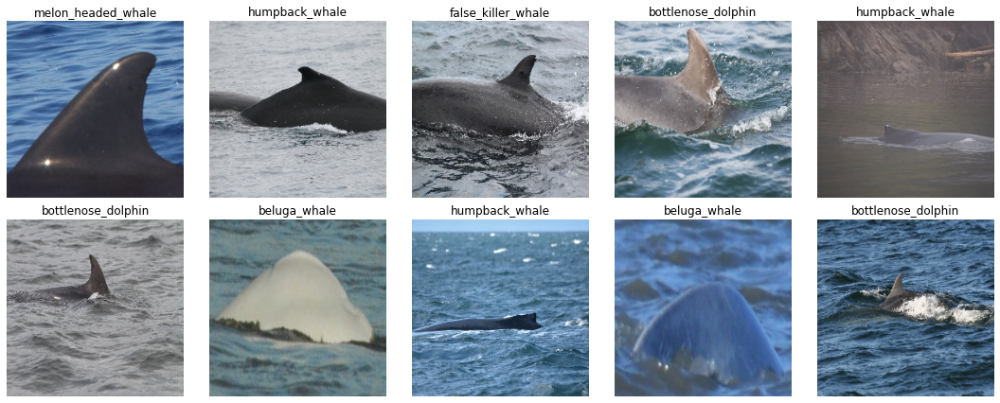

In [15]:
batch = iter(train_loader).next()
plot_batch(batch, row=2, col=5)

## Test
Let's have a look at some images from **Test** Data

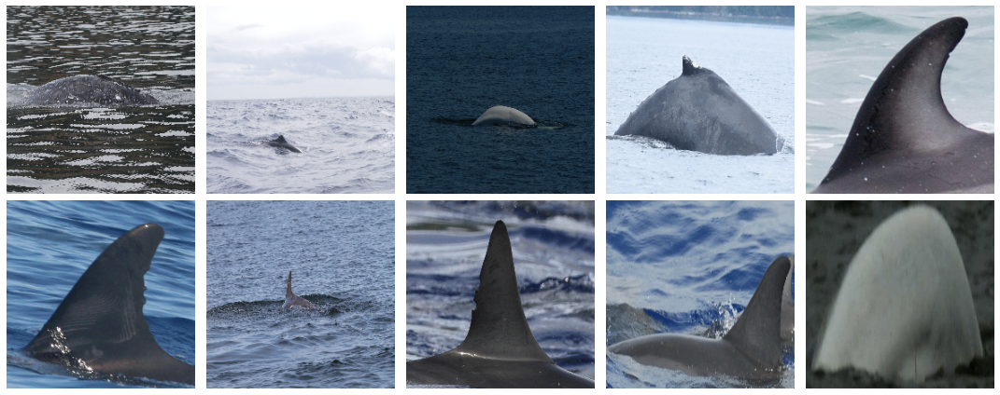

In [16]:
batch = iter(test_loader).next()
plot_batch(batch, row=2, col=5)

# Model 📦

In [17]:
class ImageModel(nn.Module):
    def __init__(self, backbone_name, pretrained=True):
        super(ImageModel, self).__init__()
        self.backbone = timm.create_model(backbone_name,
                                          pretrained=pretrained)
        self.backbone.reset_classifier(0) # to get pooled features
        
    def forward(self, x):            
        x = self.backbone(x)
        return x

In [18]:
model = ImageModel('tf_efficientnet_b0')

Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_b0_aa-827b6e33.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_b0_aa-827b6e33.pth


# Embeddings 🔰
* What is Embeddings?: 
    * An embedding is a **low-dimensional space** into which one can translate high-dimensional vectors. Ideally, an embedding captures some of the semantics of the input by placing semantically similar inputs close together in the embedding space. An embedding can be learned and reused across models.
    * Embeddings from different models belongs to different **vector-space**. Hence, we shouldn't directly compare them.
    
<div align=center> <img src="https://www.pinecone.io/images/vector_embeddings.jpg" width=600></div>
    
* How to Generate Embeddings?
    * We can train a simple **classification** model and remove its **classification head** and **TADA**, we have embedding model. For a image output of this model is **embedding** of that image.
    * In other words, we have to take output from the **pooling layers**

## Utility

In [19]:
@torch.no_grad()
def predict(model, dataloader):
    model.eval() # turn off layers such as BatchNorm or Dropout
    model.to(CFG.device) # cpu -> gpu
    embeds = []
    pbar = tqdm(dataloader, total=len(dataloader))
    for img in pbar:
        img = img.type(torch.float32) # uint8 -> float32
        img = img.to(CFG.device) # cpu -> gpu
        embed = model(img) # this is where magic happens ;)
        gpu_mem = torch.cuda.memory_reserved() / 1E9 if torch.cuda.is_available() else 0
        pbar.set_postfix(gpu_mem=f'{gpu_mem:0.2f} GB')
        embeds.append(embed.cpu().detach().numpy())
    return np.concatenate(embeds)

## Dataloader

In [20]:
train_loader = get_dataset(
    path=df.image_path.tolist(),
    target=None,
    input_shape=(224,224),
    batch_size=128*4,
)
test_loader = get_dataset(
    path=test_df.image_path.tolist(),
    target=None,
    input_shape=(224,224),
    batch_size=128*4,
)

## Generate Embeddings

In [21]:
print('# Train Embeddings:')
train_embeds = predict(model, train_loader)
np.save('train_embeds.npy', train_embeds) # save embeddings for reuse

print('# Test Embeddings:')
test_embeds = predict(model, test_loader)
np.save('test_embeds.npy', test_embeds) # save embeddings for reuse

# Train Embeddings:


  0%|          | 0/100 [00:00<?, ?it/s]

# Test Embeddings:


  0%|          | 0/55 [00:00<?, ?it/s]

# T-SNE 💫
* What is T-SNE?
    * t-Distributed Stochastic Neighbor Embedding (T-SNE) is an unsupervised, non-linear technique primarily used for data exploration and visualizing high-dimensional data. In other words, t-SNE proves the intuition of how the data is arranged in a high-dimensional space.
    
<div align=center> <img src="https://images.squarespace-cdn.com/content/v1/5bc760564d546e3f72b825c1/1556571430321-VFB052K3PFO78F5V2I2H/174Yb_MHCII_19_04_29_14_22_11_106.png" width=400></div>

* How to use T-SNE?
    * To take advantage of **GPU** we'll be using **cuml** library from **NVIDIA RAPIDS**. It can boost up the speed up to even **100x**. ;)

In [22]:
tsne = cuml.TSNE()

# Concatenate both train and test
embeds = np.concatenate([train_embeds,test_embeds])

# Fit TSNE on the embeddings and then transfer data
embed2D = tsne.fit_transform(embeds)

# Train
df['x'] = embed2D[:len(train_embeds),0]
df['y'] = embed2D[:len(train_embeds),1]

# Test
test_df['x'] = embed2D[len(train_embeds):,0]
test_df['y'] = embed2D[len(train_embeds):,1]

[W] [21:49:49.172859] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


# ⭐ WandB Logging
* We'll also log our result in **WandB** so that we can try out other plotting methods such as **PCA**, **UMAP**>
* We can plot embeddings using **WandB** in following two ways,
    1. We can directly save the **image embeddings** in wandb then plot using `2D Projection: Plot`.
    2. We can compute **t-sne** like features first and then save their result in wandb. Then plot result using `2D Projection: Plot`. In this notebook, We'll be using this 2nd way but you are encouraged to try both.
* We'll also save our **embeddings** to **WandB** so that we can re-use them later.
* After logging **WandB** output directory will look like this,

<div align=center> 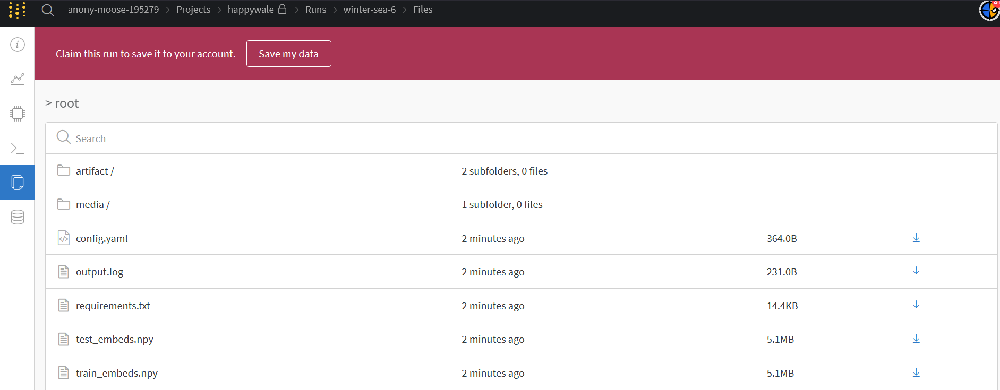</div>

* Embedding Plot will look something like this,

<div align=center>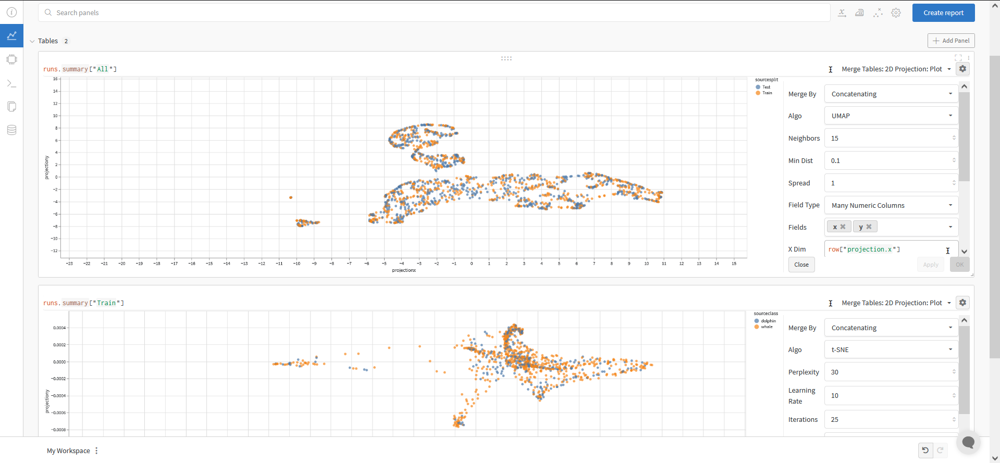</div>

### [Complete Dashboard can be accessed here 🡪](https://wandb.ai/awsaf49/happywhale-public)

In [23]:
# convert config from class to dict
config = {k:v for k,v in dict(vars(CFG)).items() if '__' not in k}

# initialize wandb project
wandb.init(project='happywhale-public', config=config)

# process data for wandb
wdf1 = pd.concat([df, test_df]).drop(columns=['image_path','predictions']) # train + test
wdf2 = df.copy() # only train as some columns of test don't have any value e.g: species

# log the data
wandb.log({"All":wdf1, 
           "Train":wdf2}) # log both result

# save embeddings to wandb for later use
wandb.save('test_embeds.npy'); # save train embeddings
wandb.save('train_embeds.npy'); # save test embeddings

# show wandb dashboard
display(ipd.IFrame(wandb.run.url, width=1080, height=720)) # show wandb dashboard

# finish logging
wandb.finish()

wandb: Currently logged in as: awsaf49 (use `wandb login --relogin` to force relogin)


# Visualize **T-SNE** ☀️
Huuuf! We have come so far. Let's visualize the **image embeddings** using **T-SNE**.

In [24]:
x_min = df.x.min()
x_max = df.x.max()
y_min = df.y.min()
y_max = df.y.max()

def plot(df, ROW, COL):
    plt.figure(figsize=(15,16*ROW/COL))
    for k in range(ROW):
        for j in range(COL):
            plt.subplot(ROW,COL,k*COL+j+1)
            row = df.iloc[k*COL+j]
            img = cv2.imread(row.image_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.axis('off')
            id_ = row['image']
            try:
                species = row['species']
                class_ = row['class']
            except:
                species = None
                class_ = None
            plt.title('id:{}\nclass:{}\nspecies:{}'.format(id_, class_, species))
            plt.imshow(img)  
    plt.tight_layout()
    plt.show()
    
def plot_tsne(df1, df2, labels=['Train', 'Test'], colors=['orange','blue']):
    plt.figure(figsize=(10,10))
    plt.scatter(df1.x, df1.y,color=colors[0],s=10,label=labels[0])
    plt.scatter(df2.x, df2.y,color=colors[1],s=10,label=labels[1], alpha=0.4)
    plt.plot([xa_mx,xa_mx],[ya_mx,yb_mx],color='black')
    plt.plot([xa_mx,xb_mx],[ya_mx,ya_mx],color='black')
    plt.plot([xb_mx,xb_mx],[ya_mx,yb_mx],color='black')
    plt.plot([xa_mx,xb_mx],[yb_mx,yb_mx],color='black')
    plt.legend()
    plt.show()

# Train Vs Test 1️⃣
* From the **T-SNE** it seems that `new_individual` can't be indentified **image embedding**. So, we can say,
    * The `new_individual` looks very similar to `old_indiviual`.
    * Or it there aren't many samples for `new_individual`.
* We need to build model keeping that in mind that `new_individual` has similar distribution as `old_individual`. Which should pose a challenge to us.

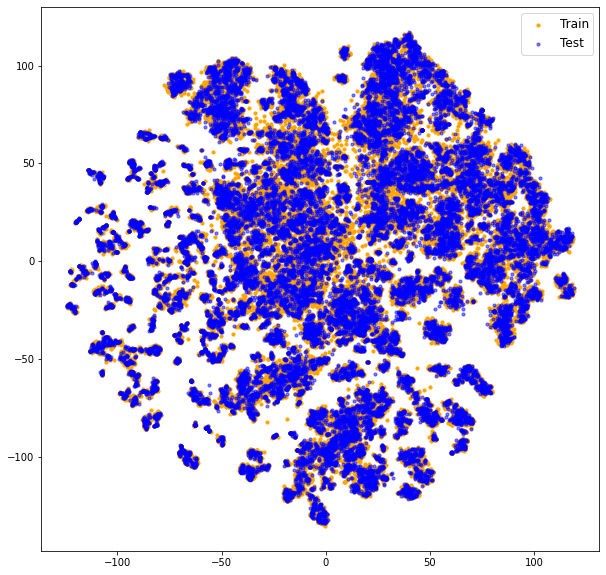

In [25]:
plt.figure(figsize=(10,10))
plt.scatter(df.x,df.y,color='orange',s=10,label='Train')
plt.scatter(test_df.x,test_df.y,color='blue',s=10,label='Test', alpha=0.5)
plt.legend(prop={'size': 12})
plt.show()

# Random **Train/Test** 2️⃣
Let's plot some train and test imaes. 
* We'll be choosing random location from vector space for images.
* For same location we'll be plotting images from both **train** & **test** data.
* The similarity between images depend on the range of our search. If we search from large location we'll have less similar images and if we search in a tiny location we'll have very similar images **(black rectangle)**. But choosing tiny location for search could result in **empty** images as not all location we have images.
* Dimension of search location can be controlled using `X_DIV` and `Y_DIV`. The bigger the value the smaller the dimension of the search.

### RANDOM: 0
>>TSNE:


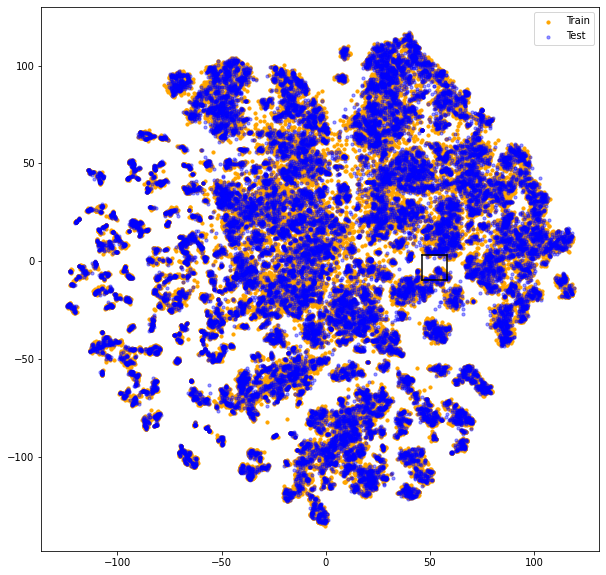

>>Train:


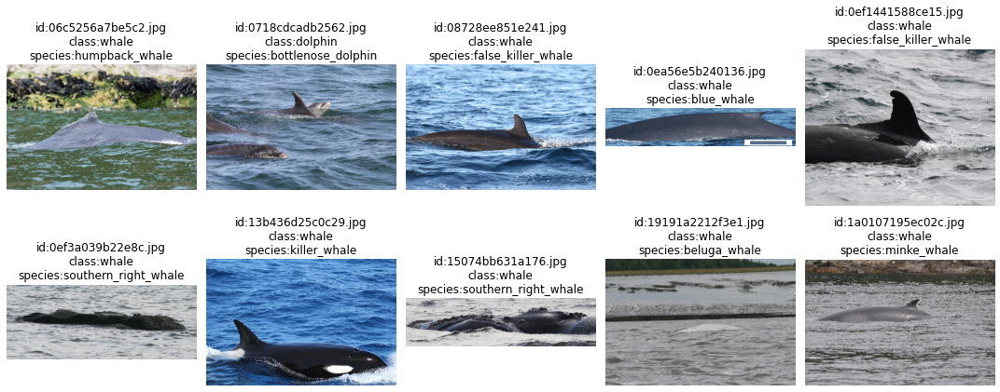

>>Test


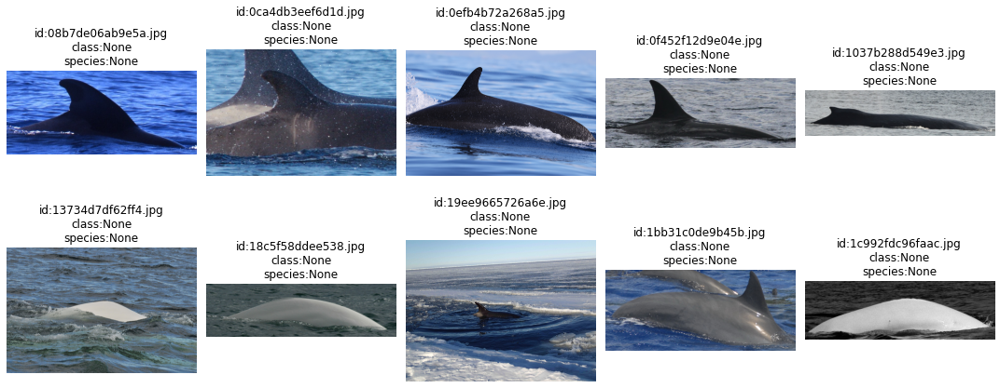




### RANDOM: 1
>>TSNE:


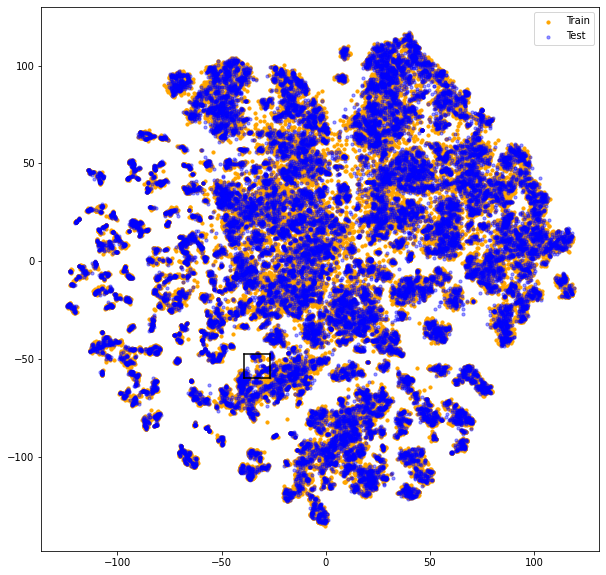

>>Train:


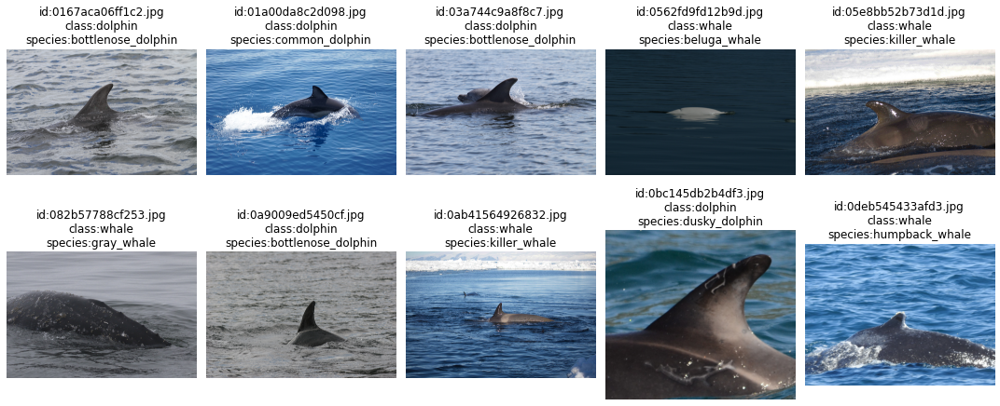

>>Test


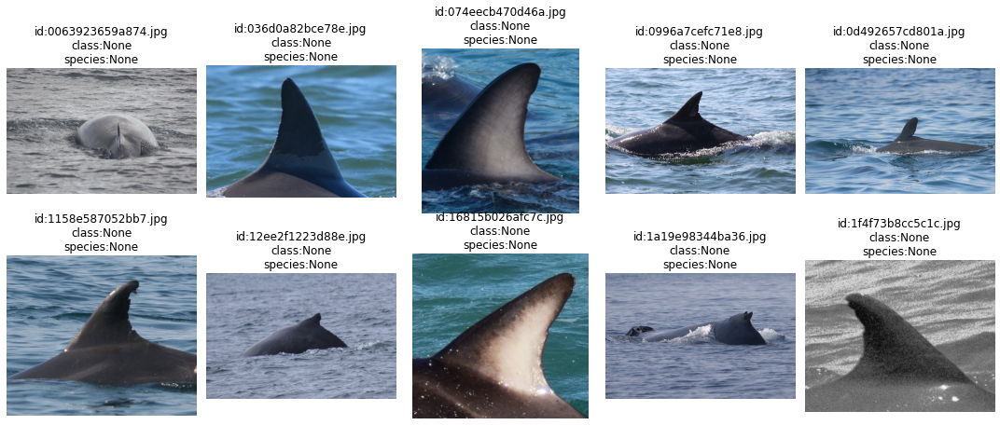




### RANDOM: 2
>>TSNE:


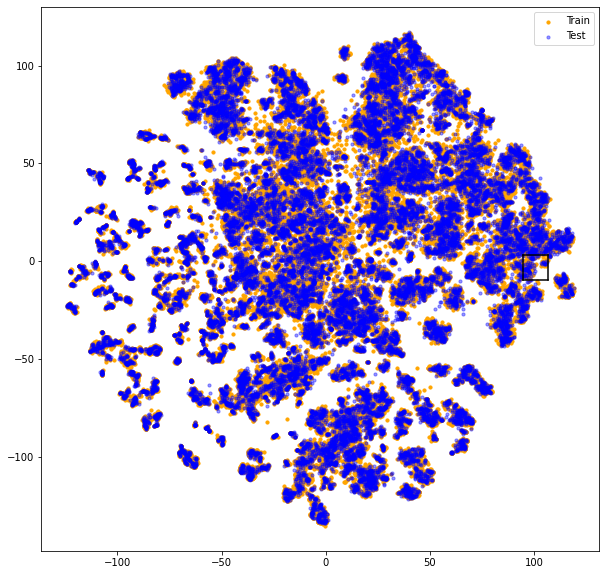

>>Train:


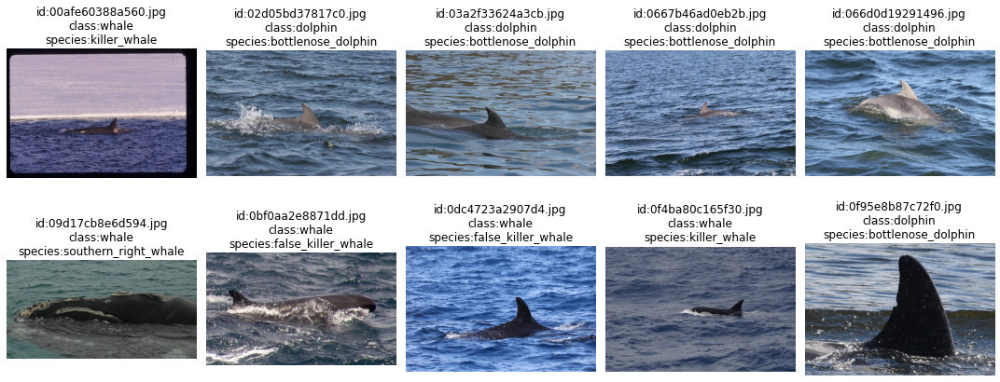

>>Test


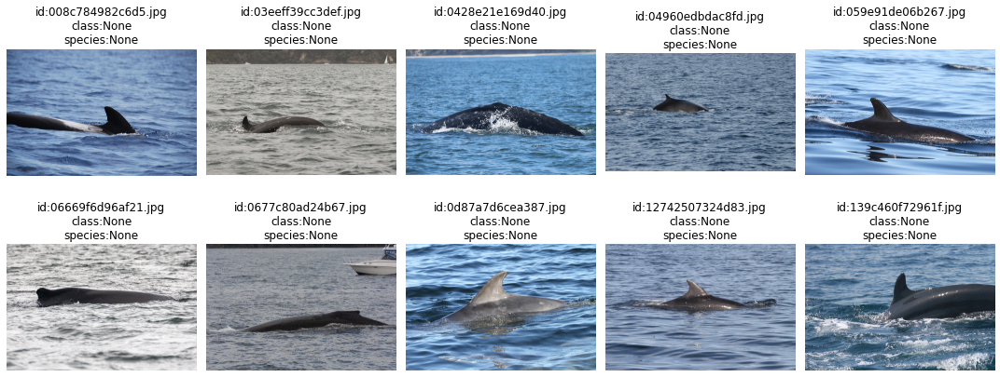




### RANDOM: 3
>>TSNE:


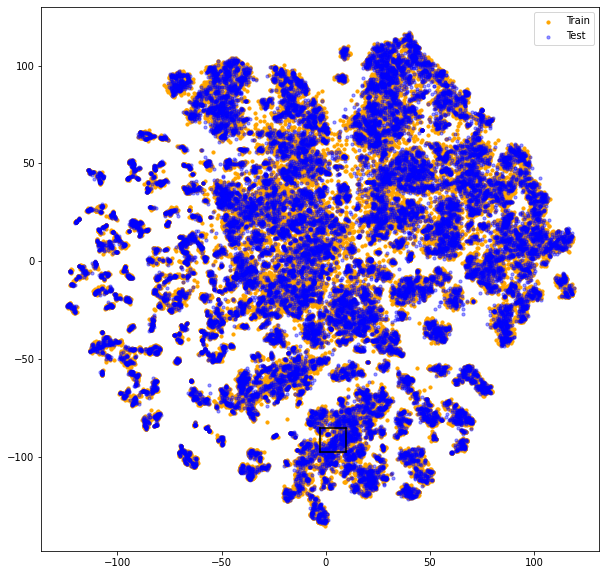

>>Train:


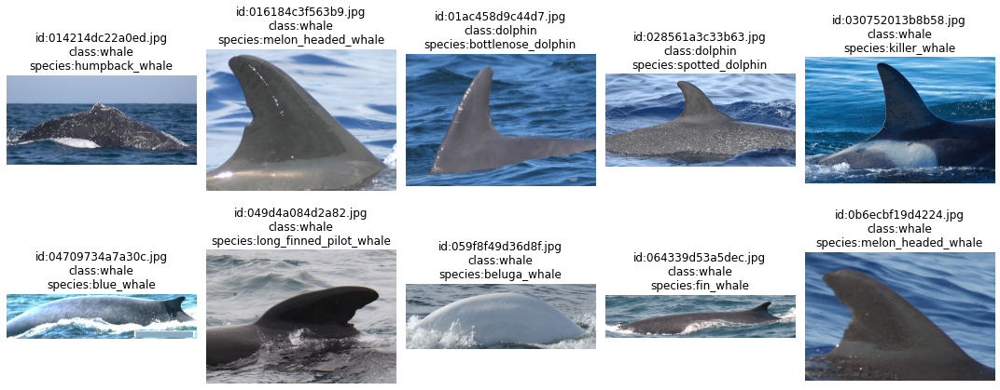

>>Test


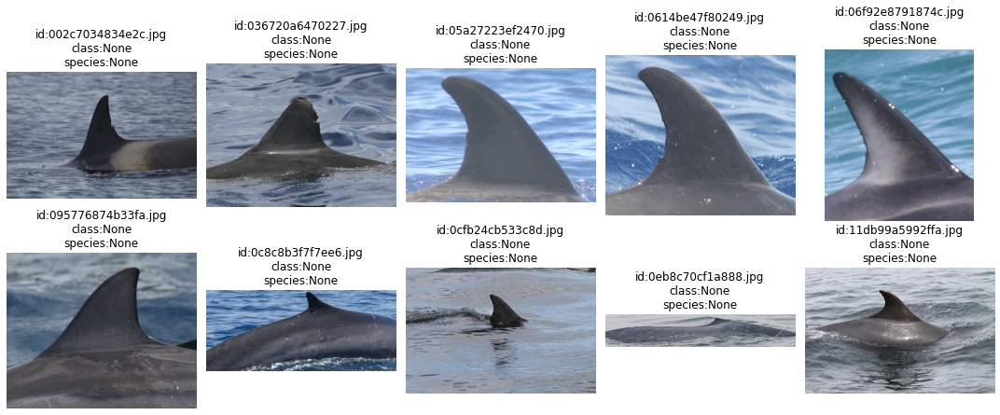




### RANDOM: 4
>>TSNE:


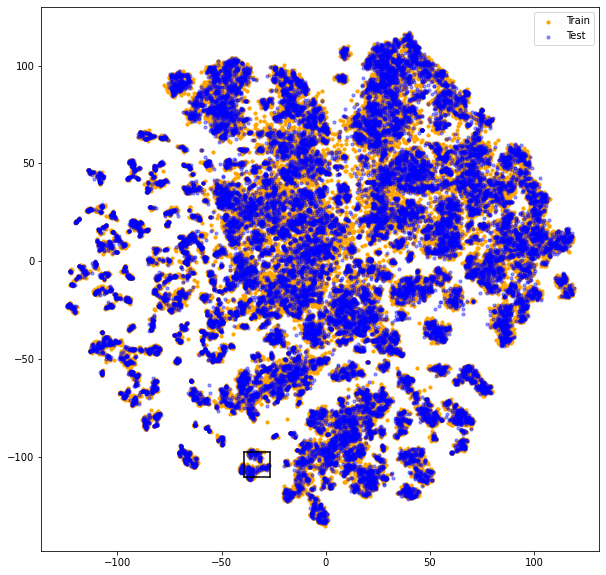

>>Train:


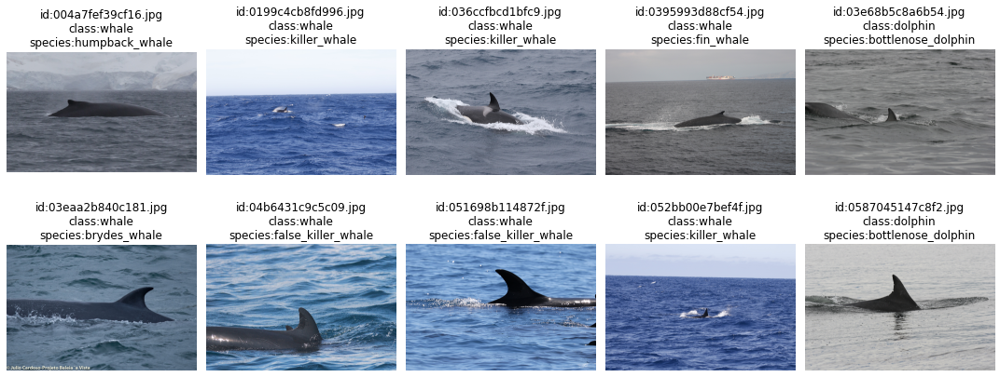

>>Test


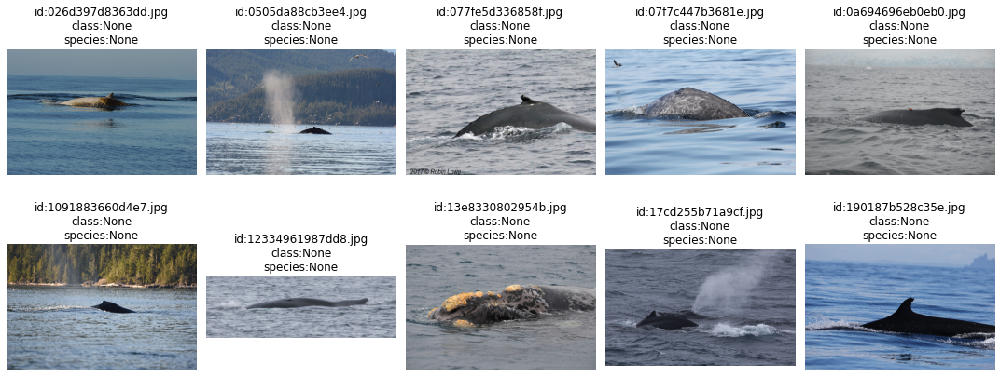

In [26]:
ROW = 2
COL = 5

X_DIV = 20; Y_DIV = 20;
x_step = (x_max - x_min)/X_DIV
y_step = (y_max - y_min)/Y_DIV

for it in range(5):
    i = 0; i2=0; trial=0;
    while i<ROW*COL:
        trial+=1
        if trial>50:
            break
        k = np.random.randint(0,X_DIV)
        j = np.random.randint(0,Y_DIV)
        xa_mx = k*x_step + x_min
        xb_mx = (k+1)*x_step + x_min
        ya_mx = j*y_step + y_min
        yb_mx = (j+1)*y_step + y_min
        df1 = df.loc[(df.x>xa_mx)&(df.x<xb_mx)&(df.y>ya_mx)&(df.y<yb_mx)]
        df2 = test_df.loc[(test_df.x>xa_mx)&(test_df.x<xb_mx)&(test_df.y>ya_mx)&(test_df.y<yb_mx)]
        i  = len(df1)
        i2 = len(df2)
    print(f'### RANDOM: {it}')
    
    print('>>TSNE:')
    plot_tsne(df, test_df)

    print('>>Train:')
    if i>=ROW*COL:
        plot(df1, ROW, COL)
    else:
        print('Not Found')

    print('>>Test')
    if i2>=ROW*COL:
        plot(df2, ROW, COL)
    else:
        print('Not Found')
    print('\n\n')

# Whale Vs Dolphin 3️⃣
Let's plot the **image embeddings** of Whales and Dolphins using **T-SNE**.
* From **Train/Test** section if you're wondering that what we were expecting to see, check out following images.
* It is clearly visible that there are some Whales which look very different from Dolphins. We were actually expecting similar pattern in **Train/Test** Plot.

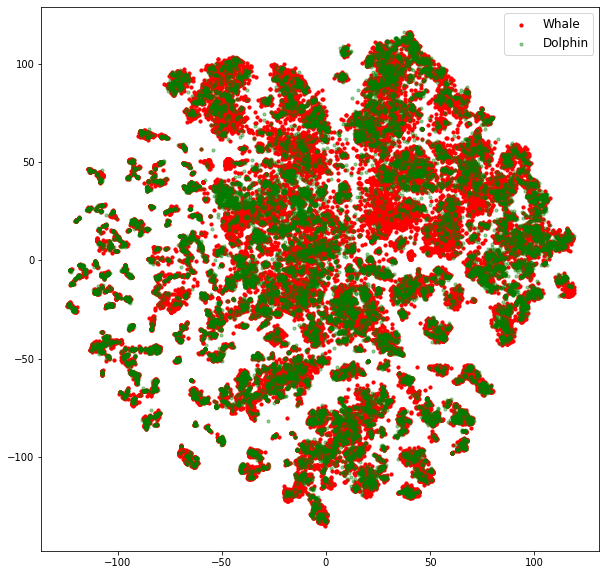

In [27]:
plt.figure(figsize=(10,10))
w_df = df[df['class']=='whale']
plt.scatter(w_df.x,w_df.y,color='red',s=10,label='Whale')

d_df = df[df['class']=='dolphin']
plt.scatter(d_df.x,d_df.y,color='green',s=10,label='Dolphin', alpha=0.4)
plt.legend(prop={'size': 12})

plt.show()

# Random **Whale/Dolphin** 4️⃣
Let's plot some images from Whales and Dolphins

### RANDOM: 0
>>TSNE:


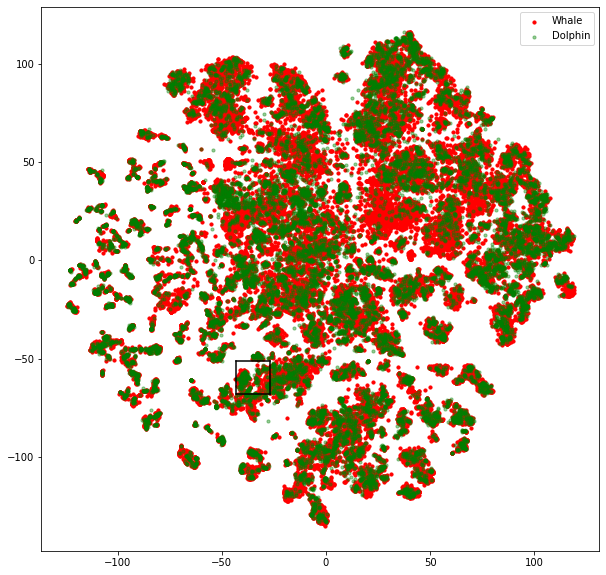

>>Whale:


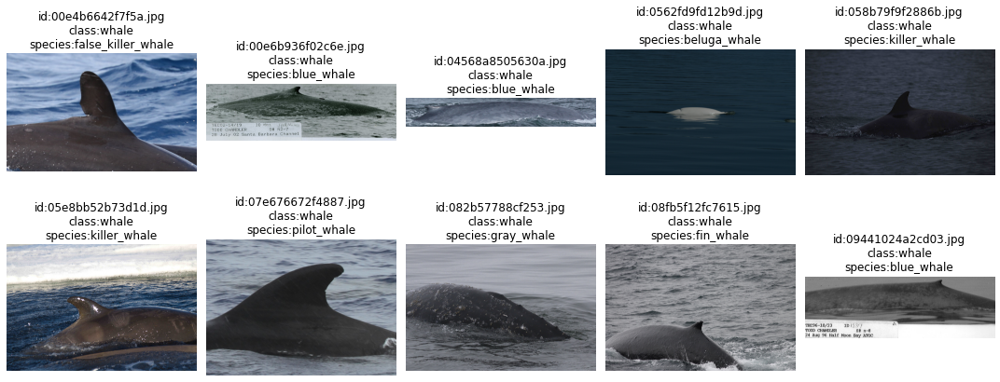

>>Dolphin:


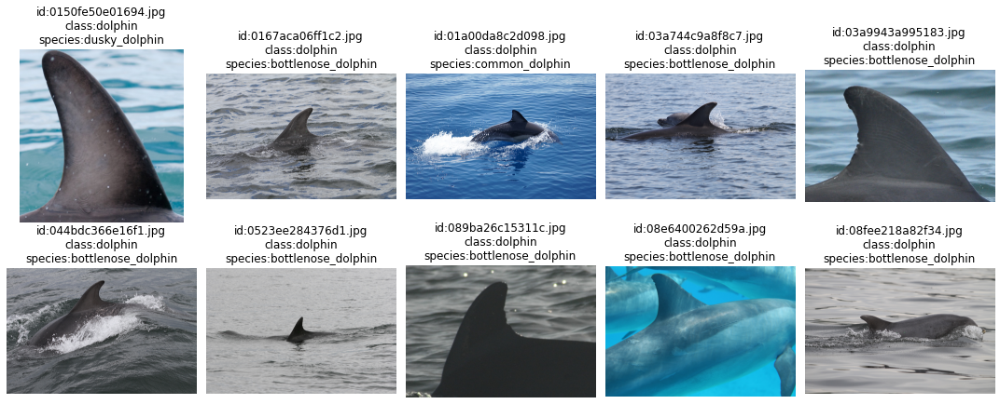




### RANDOM: 1
>>TSNE:


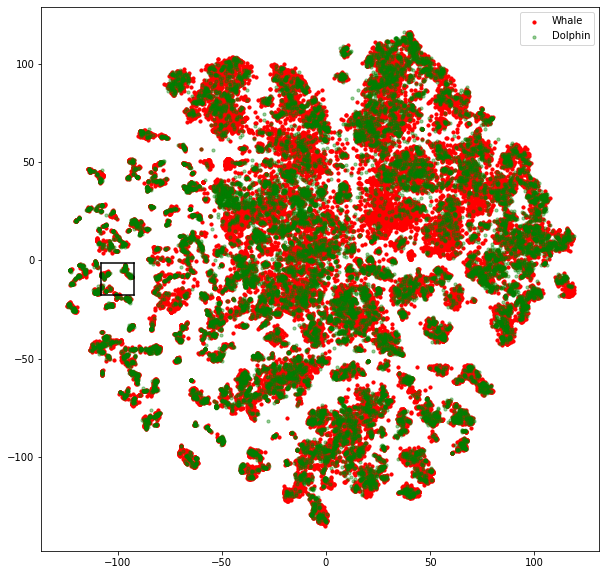

>>Whale:


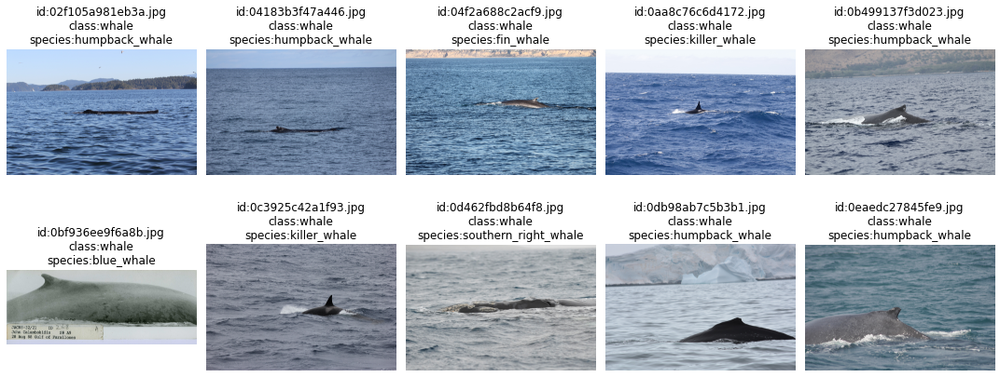

>>Dolphin:


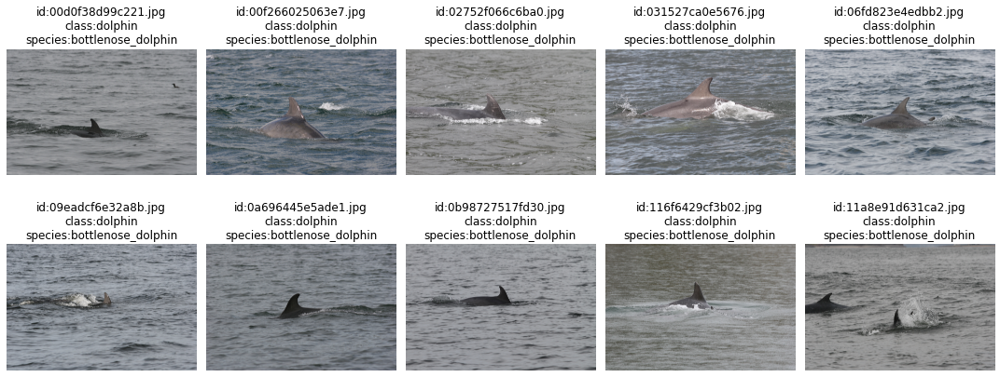




### RANDOM: 2
>>TSNE:


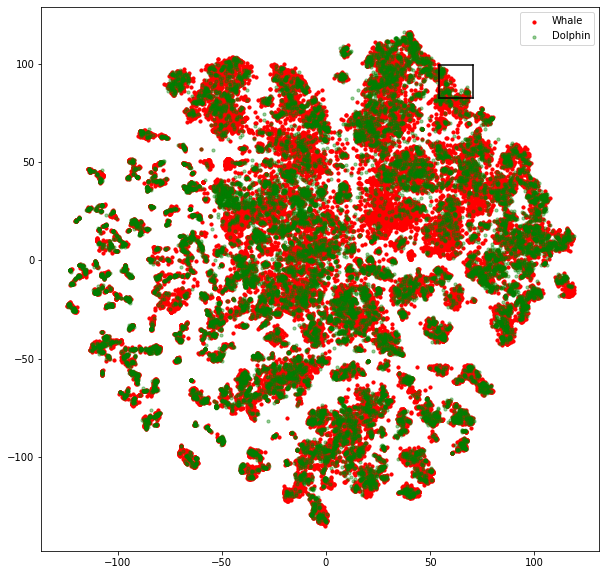

>>Whale:


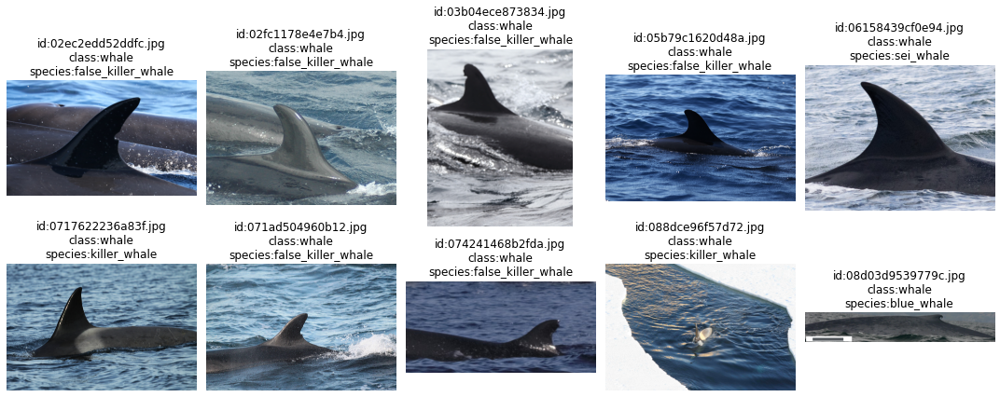

>>Dolphin:


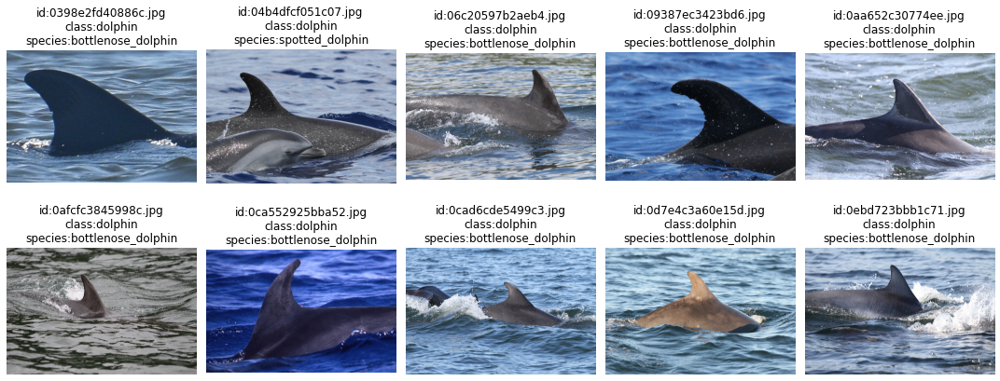




### RANDOM: 3
>>TSNE:


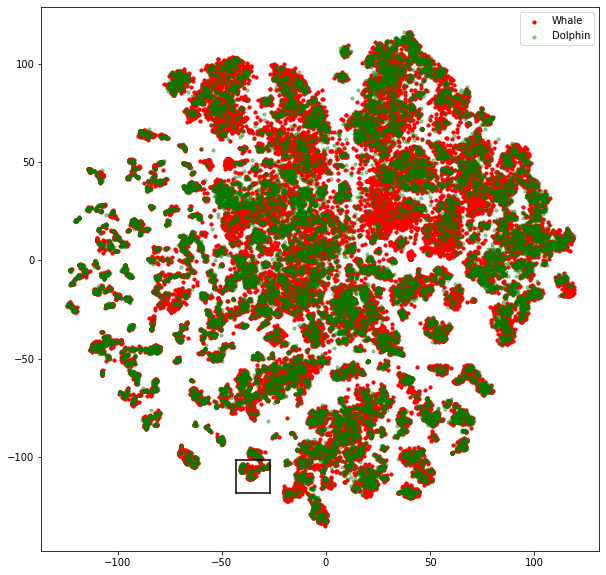

>>Whale:


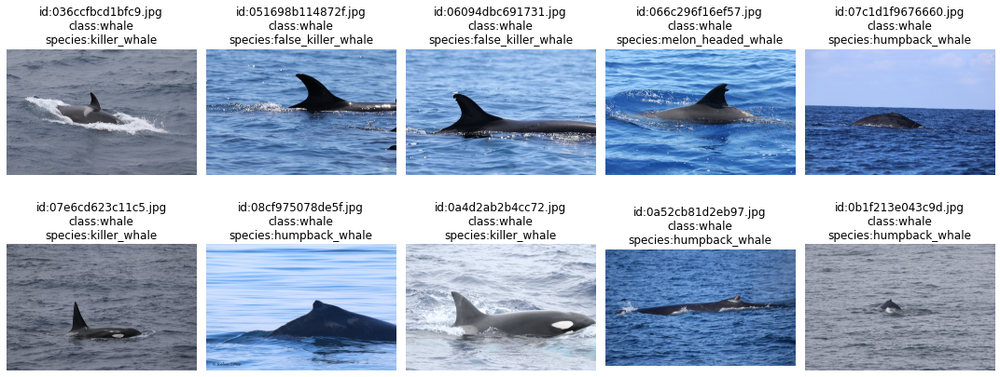

>>Dolphin:


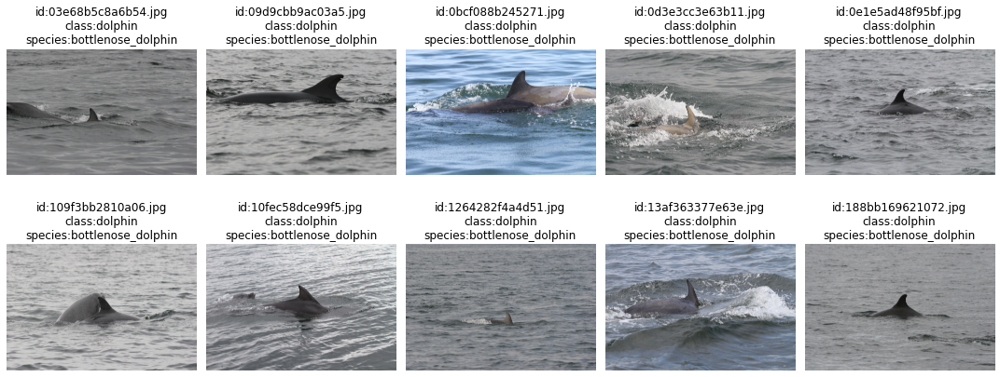




### RANDOM: 4
>>TSNE:


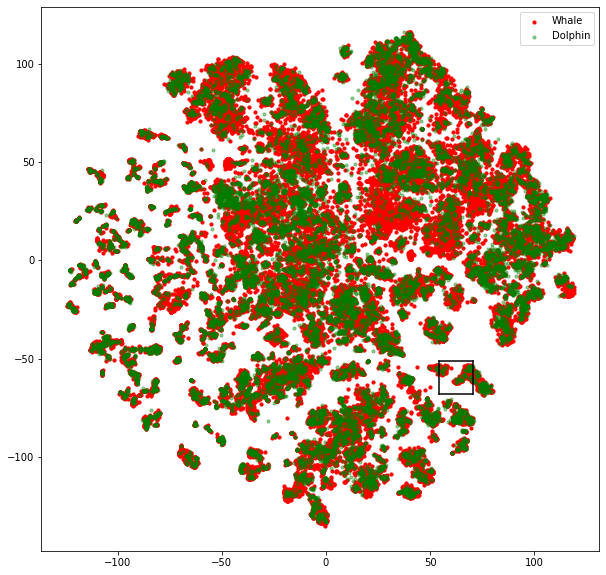

>>Whale:


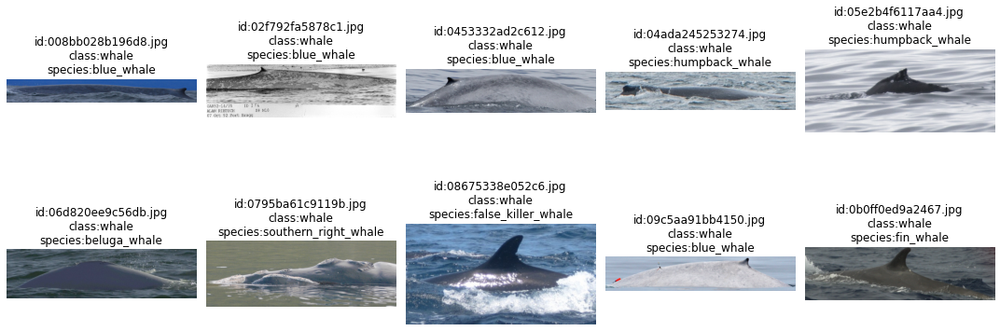

>>Dolphin:


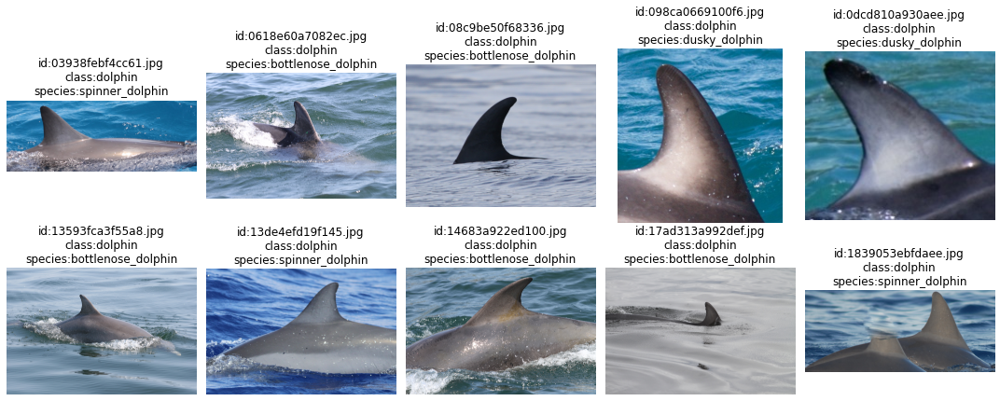

In [28]:
ROW = 2
COL = 5

X_DIV = 15; Y_DIV = 15;
x_step = (x_max - x_min)/X_DIV
y_step = (y_max - y_min)/Y_DIV

w_df = df[df['class']=='whale']
d_df = df[df['class']=='dolphin']

for it in range(5):
    i = 0; i2=0; trial=0;
    while i<ROW*COL:
        trial+=1
        if trial>50:
            break
        k = np.random.randint(0,X_DIV)
        j = np.random.randint(0,Y_DIV)
        xa_mx = k*x_step + x_min
        xb_mx = (k+1)*x_step + x_min
        ya_mx = j*y_step + y_min
        yb_mx = (j+1)*y_step + y_min
        df1 = w_df.loc[(w_df.x>xa_mx)&(w_df.x<xb_mx)&(w_df.y>ya_mx)&(w_df.y<yb_mx)]
        df2 = d_df.loc[(d_df.x>xa_mx)&(d_df.x<xb_mx)&(d_df.y>ya_mx)&(d_df.y<yb_mx)]
        i  = len(df1)
        i2 = len(df2)
    print(f'### RANDOM: {it}')
    
    print('>>TSNE:')
    plot_tsne(w_df, d_df, labels=['Whale', 'Dolphin'], colors=['red', 'green'])

    print('>>Whale:')
    if i>=ROW*COL:
        plot(df1, ROW, COL)
    else:
        print('Not Found')

    print('>>Dolphin:')
    if i2>=ROW*COL:
        plot(df2, ROW, COL)
    else:
        print('Not Found')
    print('\n\n')

# Whale Species 5️⃣
Let's look at the species of Whales in **T-SNE**.

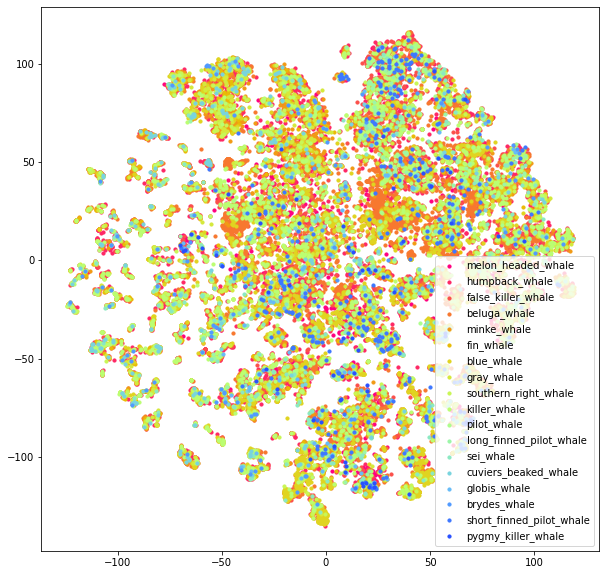

In [29]:
plt.figure(figsize=(10,10))
n_species = w_df.species.nunique()
colors = gen_colors(n=n_species)
for i, species in enumerate(w_df.species.unique()):
    s_df = w_df.query("species==@species")
    color = '#%02x%02x%02x'%tuple(int(c) for c in colors[i])
    plt.scatter(s_df.x,s_df.y,s=10,color=color, label=species)
plt.legend(prop={'size': 10})
plt.show()

# Dolphin Species 6️⃣
Let's look at the species of Dolphin in **T-SNE**.

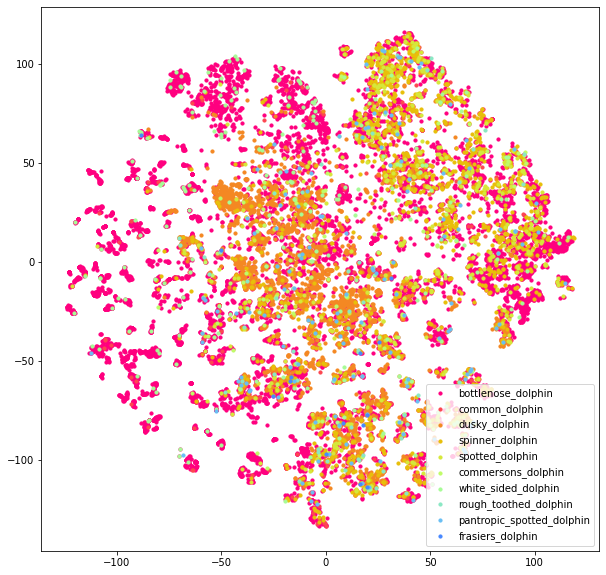

In [30]:
plt.figure(figsize=(10,10))
n_species = d_df.species.nunique()
colors = gen_colors(n=n_species)
for i, species in enumerate(d_df.species.unique()):
    s_df = d_df.query("species==@species")
    color = '#%02x%02x%02x'%tuple(int(c) for c in colors[i])
    plt.scatter(s_df.x,s_df.y,s=10,color=color, label=species)
plt.legend(prop={'size': 10})
plt.show()

# Conclusion 🏁
* It can be noticed that **train** and **test** distirubtion is very close to earch other.
* Even though `new_individual` never appears in **train** data, they have similar distribution as **train** data.
* It is also possible that there aren't many samples of `new_individual` in the **test** data. Hence, their distribution wasn't that visible in **T-SNE** plot.
* Some Whales are very distinct comparing Dolphins whereas most of the Dolphins resemblance Whales.
* The `killer`, `southern` and `pilot` Whales dominates over other species.
* The `bottlenose` and `dusky` Dolphins dominates over other speceis.

# Reference 💡
* [RAPIDS cuML kNN - Find Duplicates](https://www.kaggle.com/cdeotte/rapids-cuml-knn-find-duplicates) by Chris Deotte

# Remove Files ✂️

In [31]:
!rm -rf ./wandb